In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
#import scrublet as scr # requires 'pip install scrublet'
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

mpl.rcParams['pdf.fonttype']=42
mpl.rcParams['font.sans-serif']='Arial'

In [2]:
np.random.seed(0)
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.8
scanpy      1.8.2
sinfo       0.3.1
-----
PIL                 8.0.1
anndata             0.7.8
backcall            0.2.0
bottleneck          1.3.2
cffi                1.14.3
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2.30.0
dateutil            2.8.2
decorator           4.4.2
entrypoints         0.3
h5py                2.10.0
igraph              0.9.1
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.1
joblib              0.17.0
jupyter_server      1.13.5
kiwisolver          1.3.0
leidenalg           0.8.4
llvmlite            0.34.0
matplotlib          3.3.2
mkl                 2.3.0
mpl_toolkits        NA
natsort             8.1.0
nt                  NA
ntsecuritycon       NA
numba               0.51.2
numexpr             2.7.1
numpy               1.19.2
packaging           20.4
pandas              1.1.3
pa

In [3]:
adata = sc.read_h5ad('sc_raw.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 138681 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Organization', 'Patients_ID', 'percent.mt', 'percent.rb', 'percent.HB', 'RNA_snn_res.0.8', 'seurat_clusters', 'singleR', 'celltype'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap'
    varm: 'HARMONY', 'PCs'

In [5]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,Organization,Patients_ID,percent.mt,percent.rb,percent.HB,RNA_snn_res.0.8,seurat_clusters,singleR,celltype
GSM5573466_AAACCTGAGGCTACGA_8,GSM5573466,10969.0,3501,Normal,NGCII518,10.146777,12.544443,0.0,17,24,Endothelial_cells,Endothelial
GSM5573466_AAACCTGAGGTTCCTA_8,GSM5573466,2310.0,1114,Normal,NGCII518,1.255411,14.718615,0.0,6,14,Epithelial_cells,Epithelial
GSM5573466_AAACCTGGTTGACGTT_8,GSM5573466,4204.0,1673,Normal,NGCII518,13.249286,14.890580,0.0,32,6,NK_cell,NK cell
GSM5573466_AAACCTGTCCATGAAC_8,GSM5573466,4047.0,1558,Normal,NGCII518,13.689152,14.875216,0.0,32,6,NK_cell,NK cell
GSM5573466_AAACGGGAGTGTACGG_8,GSM5573466,2337.0,1027,Normal,NGCII518,7.744972,17.715019,0.0,0,0,T_cells,T cell
...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5573505_TTTGGTTGTGAGCTCC.1_40,GSM5573505,5265.0,1575,Tumor,NGCII545,9.610636,23.741690,0.0,30,4,Monocyte,macrophag
GSM5573505_TTTGGTTTCACCTCGT.1_40,GSM5573505,5887.0,2208,Tumor,NGCII545,8.357398,14.574486,0.0,14,21,T_cells,T cell
GSM5573505_TTTGGTTTCTTCCCAG.1_40,GSM5573505,10538.0,1327,Tumor,NGCII545,3.871702,4.545455,0.0,23,3,B_cell,plasma cell
GSM5573505_TTTGTTGCAGACACAG.1_40,GSM5573505,2198.0,949,Tumor,NGCII545,8.826206,14.968153,0.0,2,10,Monocyte,macrophag


... storing 'orig.ident' as categorical
... storing 'Organization' as categorical
... storing 'Patients_ID' as categorical
... storing 'singleR' as categorical
... storing 'celltype' as categorical


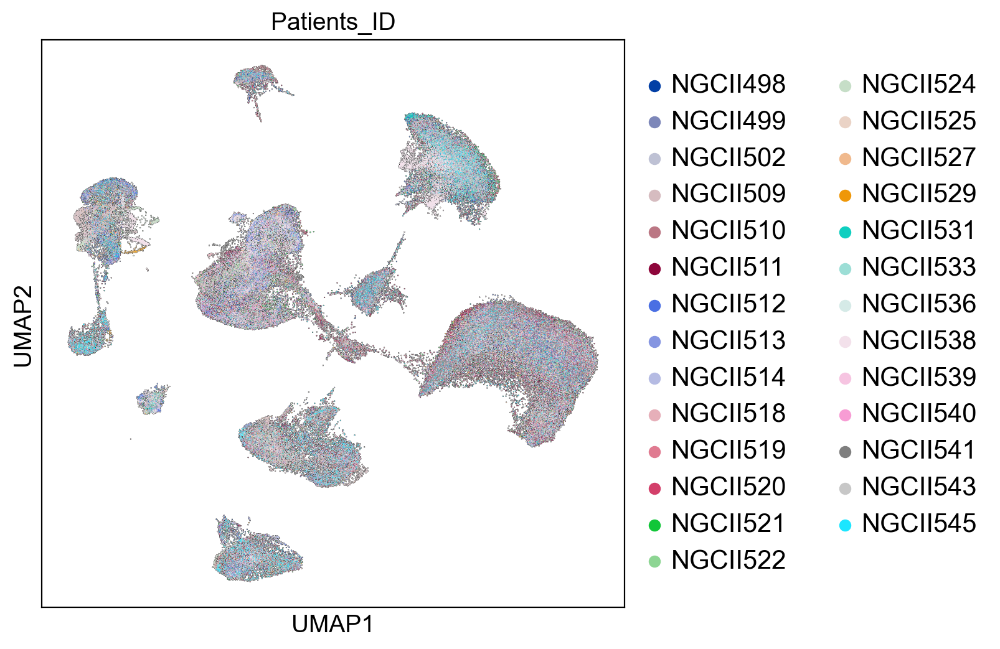

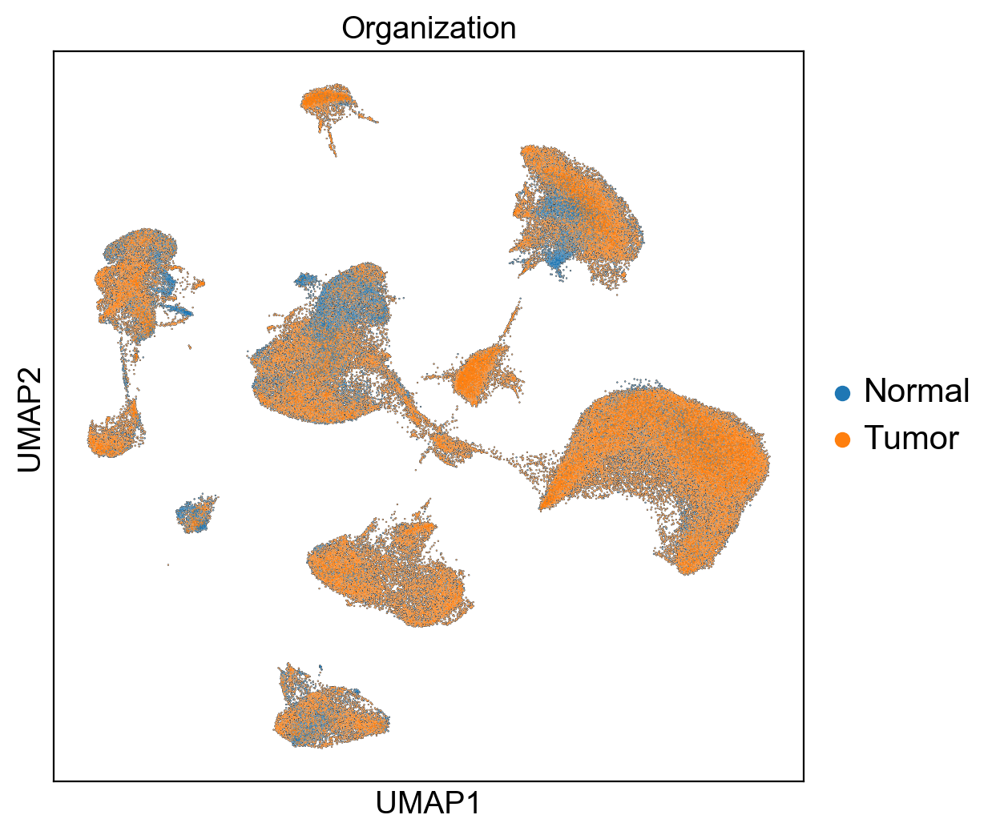

In [6]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(6,6))
type =['Patients_ID','Organization']
for i in type:
    sc.pl.umap(adata, color=i,add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline=1,frameon=True,ncols=1,save = i
               )

In [7]:
adata.obs["celltype"] = adata.obs["celltype"].astype('category')
adata.obs["celltype"].cat.categories

Index(['B cell', 'Endothelial', 'Epithelial', 'Fibroblasts', 'NK cell',
       'T cell', 'dendritic cell', 'macrophag', 'mast cell', 'plasma cell'],
      dtype='object')

In [8]:
new_colors = np.empty(len(adata.obs["celltype"].cat.categories), dtype=object) 
new_colors[[0]] = '#FF3333' # B cell
new_colors[[1]] = '#666699' # Endothelial
new_colors[[2]] = '#003399' # Epithelial
new_colors[[3]] = '#33FF99' # Fibroblasts
new_colors[[4]] = '#FFFF33' # NK cell
new_colors[[5]] = '#FF6633' # T cell
new_colors[[6]] = '#00FFCC' # dendritic cell
new_colors[[7]] = '#009999' # macrophag
new_colors[[8]] = '#6600FF' # mast cell
new_colors[[9]] = '#FF0066' # plasma cell
adata.uns["celltype_colors"] = new_colors
new_colors

array(['#FF3333', '#666699', '#003399', '#33FF99', '#FFFF33', '#FF6633',
       '#00FFCC', '#009999', '#6600FF', '#FF0066'], dtype=object)

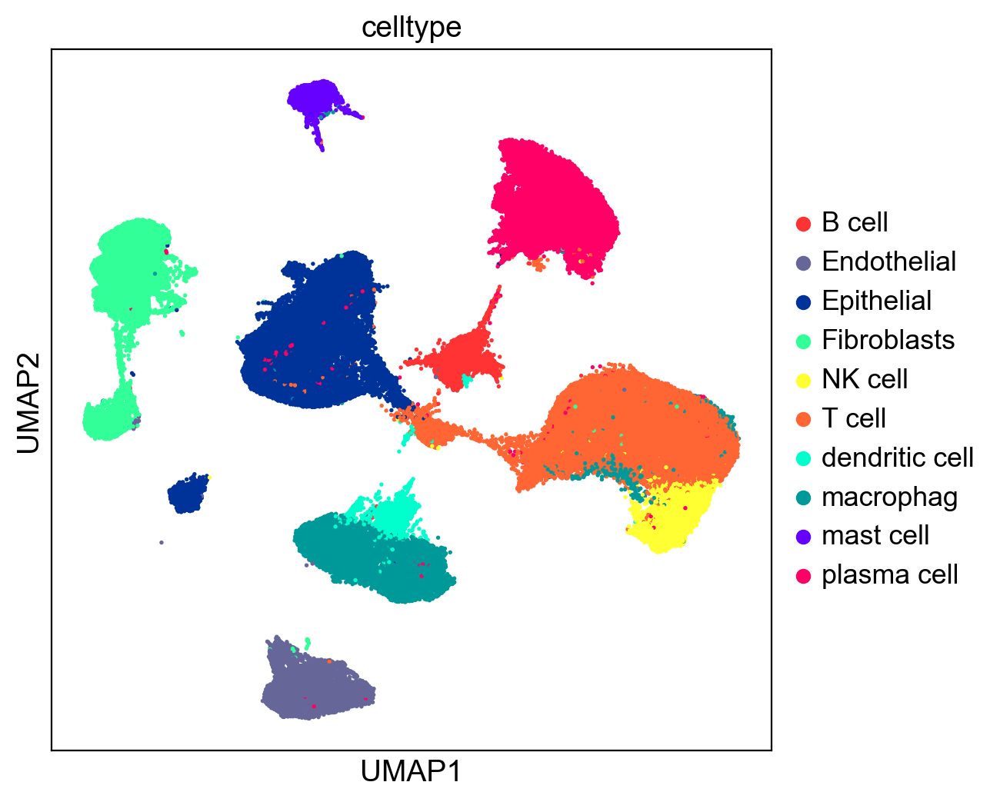

In [9]:
sc.pl.umap(adata, color=['celltype'],size=15) 

In [10]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.umap(adata, color='celltype', save='celltype1.pdf', show=False, size=3) 
sc.pl.umap(adata, color='celltype', save='celltype1.png', show=False, size=3) 
sc.pl.umap(adata, color='celltype', save='legon1.pdf', show=False, size=3, legend_loc="on data", legend_fontsize=6)
sc.pl.umap(adata, color='celltype', save='legon1.png', show=False, size=3, legend_loc="on data", legend_fontsize=6)

<AxesSubplot:title={'center':'celltype'}, xlabel='UMAP1', ylabel='UMAP2'>

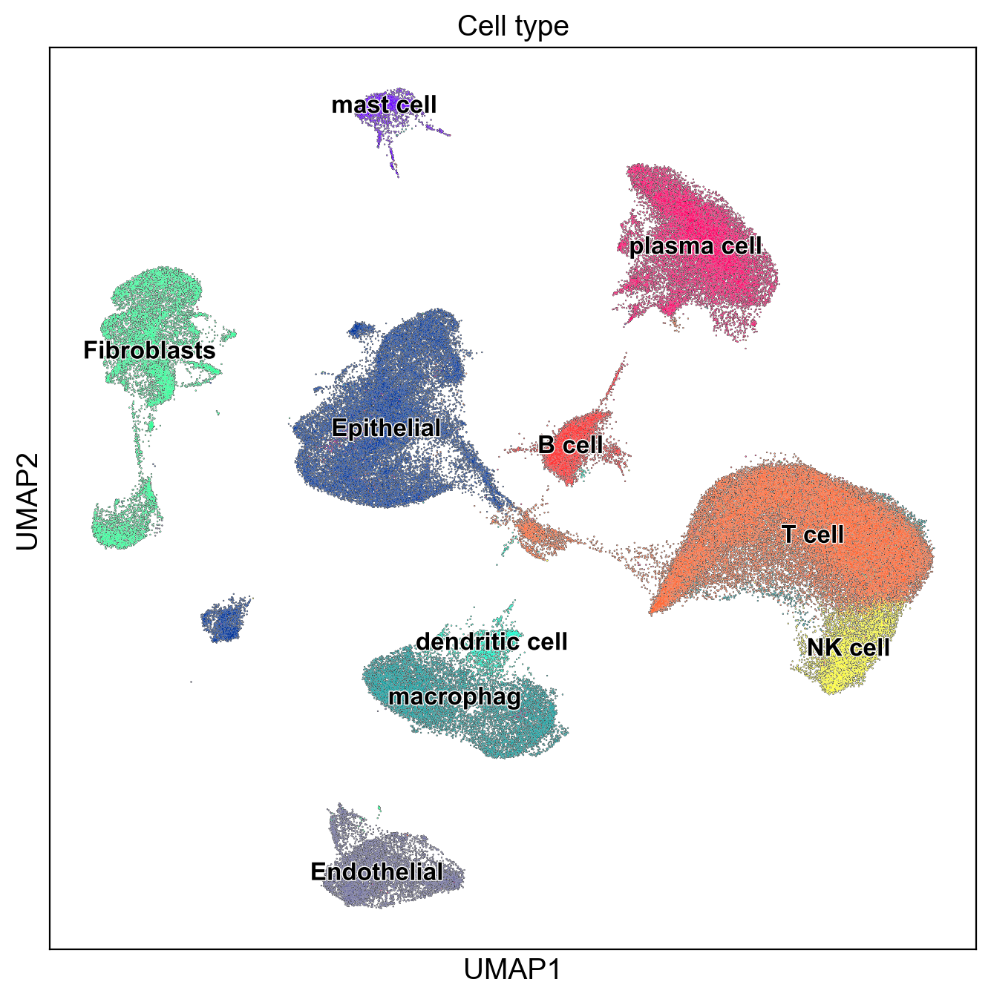

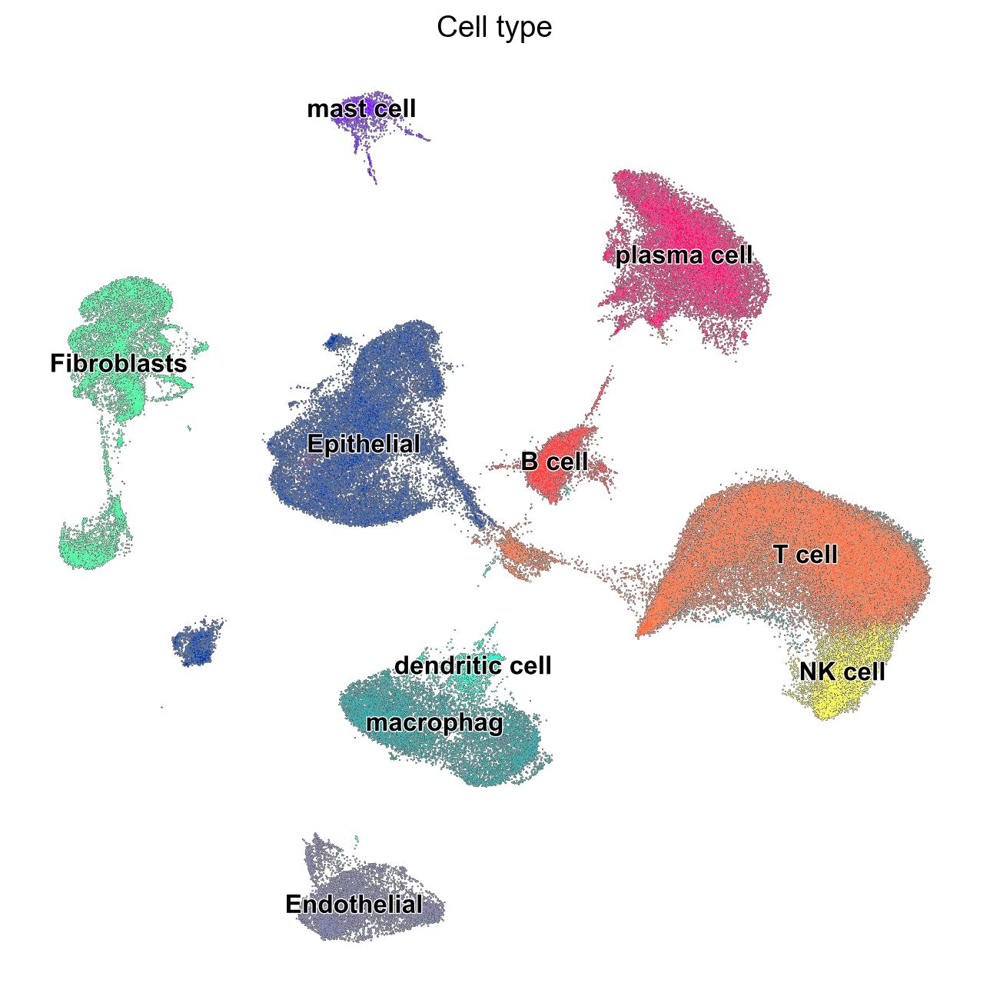

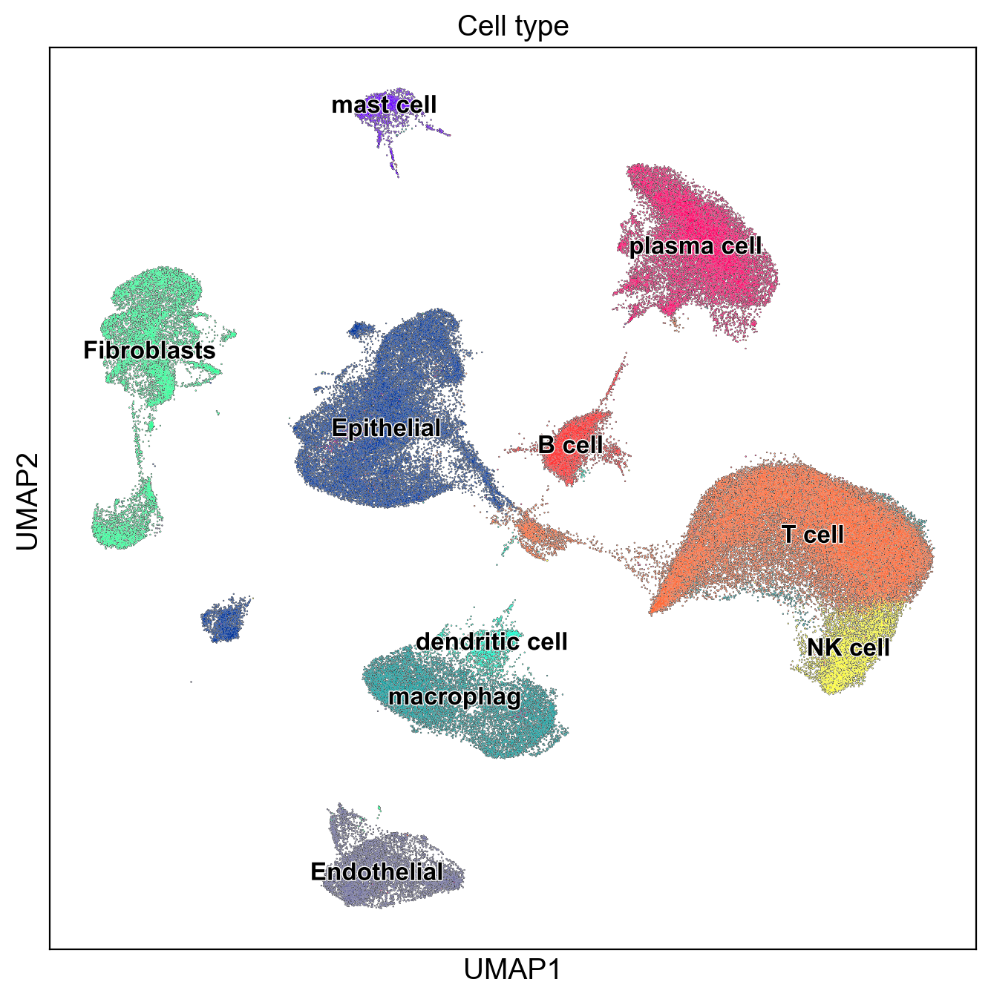

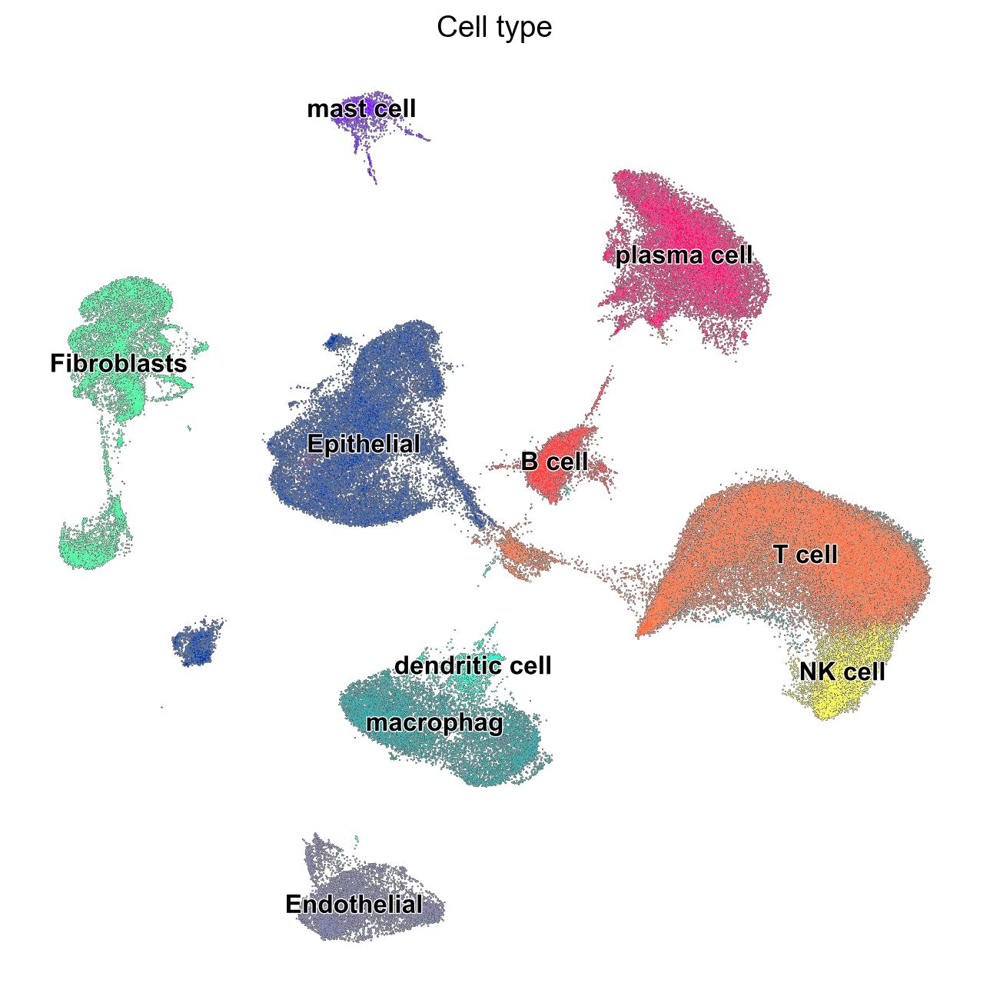

In [11]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.umap(adata, color='celltype', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=1,frameon=True,
               title='Cell type', save='celltype2.pdf')
sc.pl.umap(adata, color='celltype', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=1,frameon=False,
               title='Cell type', save='celltype3.pdf')
sc.pl.umap(adata, color='celltype', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=1,frameon=True,
               title='Cell type', save='celltype2.png')
sc.pl.umap(adata, color='celltype', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=1,frameon=False,
               title='Cell type', save='celltype3.png')

In [12]:
cluster = {
    'B cell':["MS4A1"],
    'Endothelial':["PLVAP"],
    'Epithelial':["EPCAM"],
    'Fibroblasts':["LUM","DCN"],
    'NK cell':['KLRD1'],
    'T cell':["CD8A","GZMH"],
    'dendritic cell':['PLD4'],
    'macrophag':["CD163"],
    'mast cell':["KIT"],
    'plasma cell':["TNFRSF17"]   
}

In [13]:
marker_list = []

for k,v in cluster.items():
    if isinstance(v,list):
        marker_list.extend(v)
    else:
        marker_list.append(v)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_celltype']`


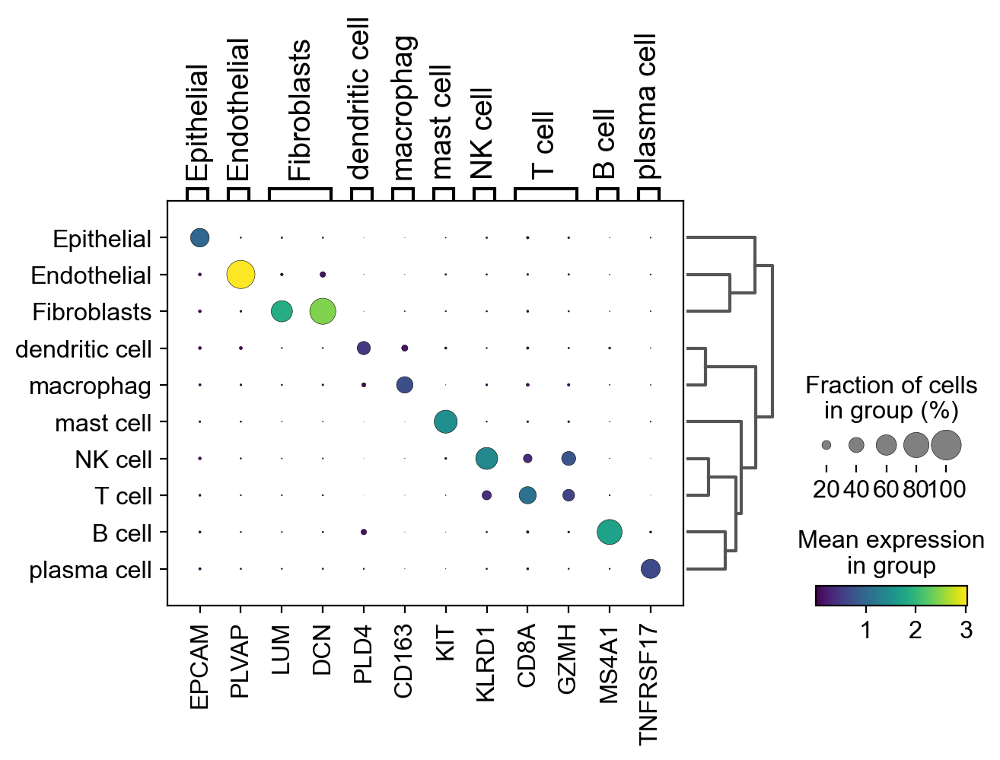

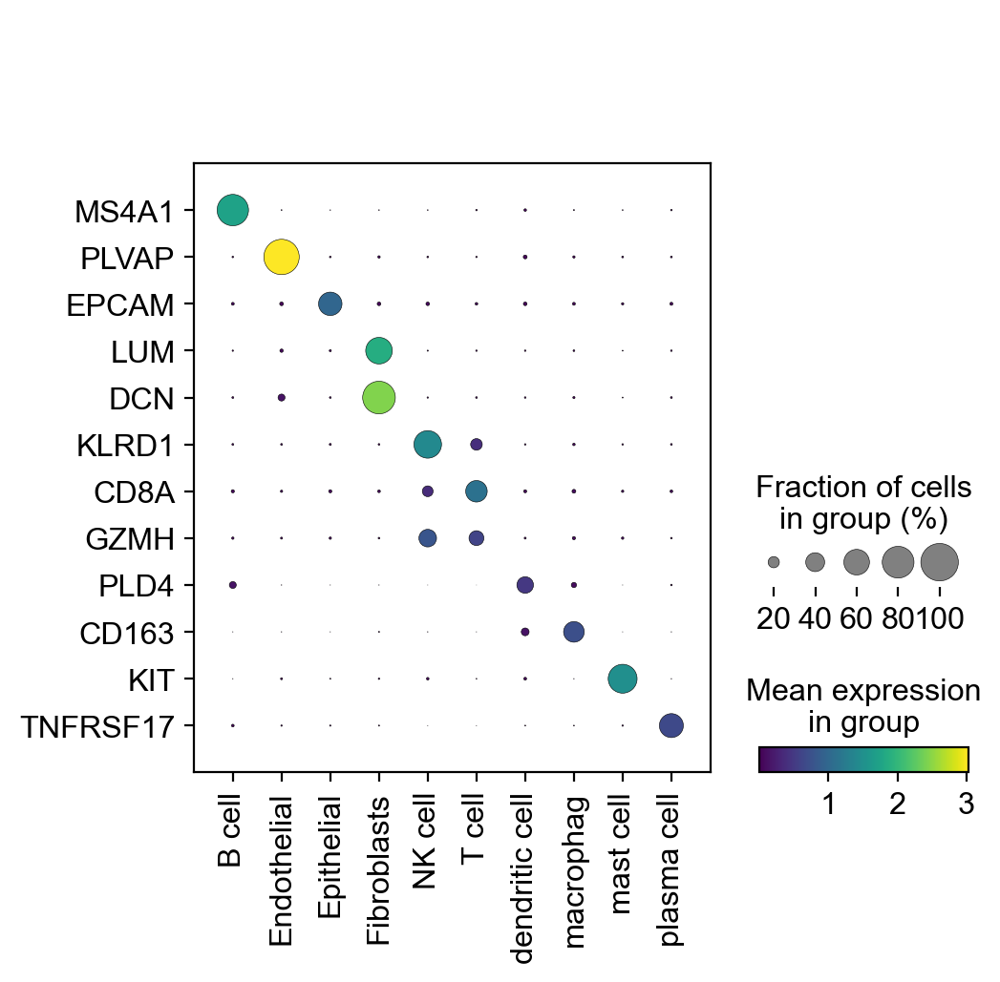

In [14]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.dotplot(adata, cluster, 'celltype', dendrogram=True,cmap='viridis',save='marker1.pdf')
sc.pl.dotplot(adata,marker_list, 'celltype',cmap='viridis',swap_axes=True,save='marker2.pdf')

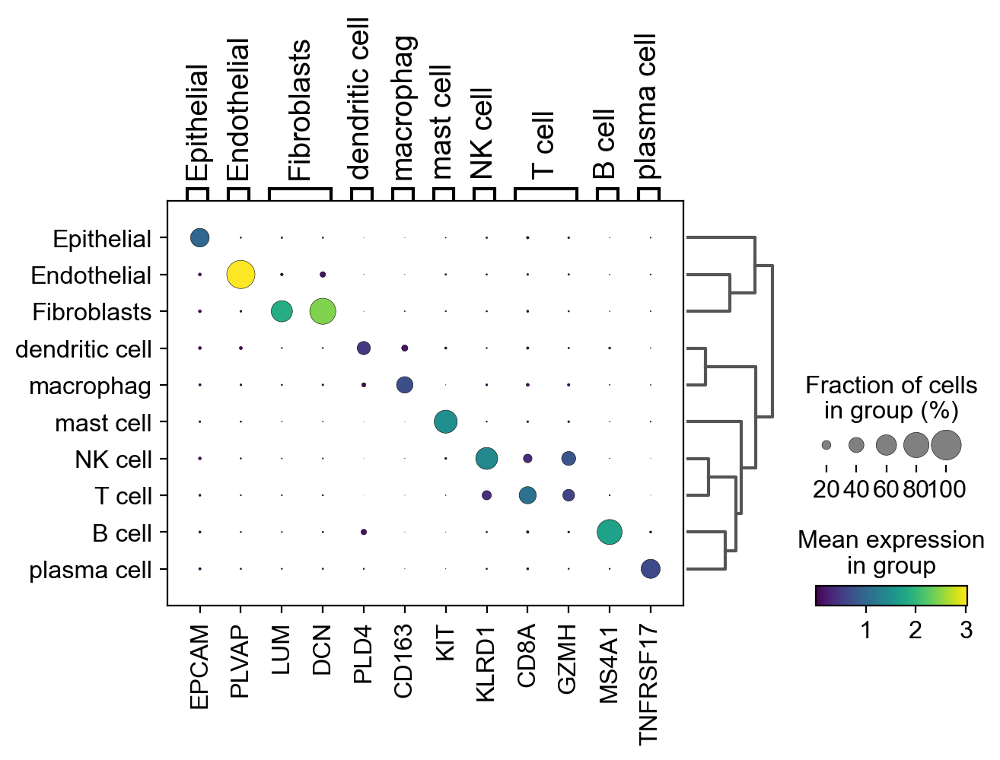

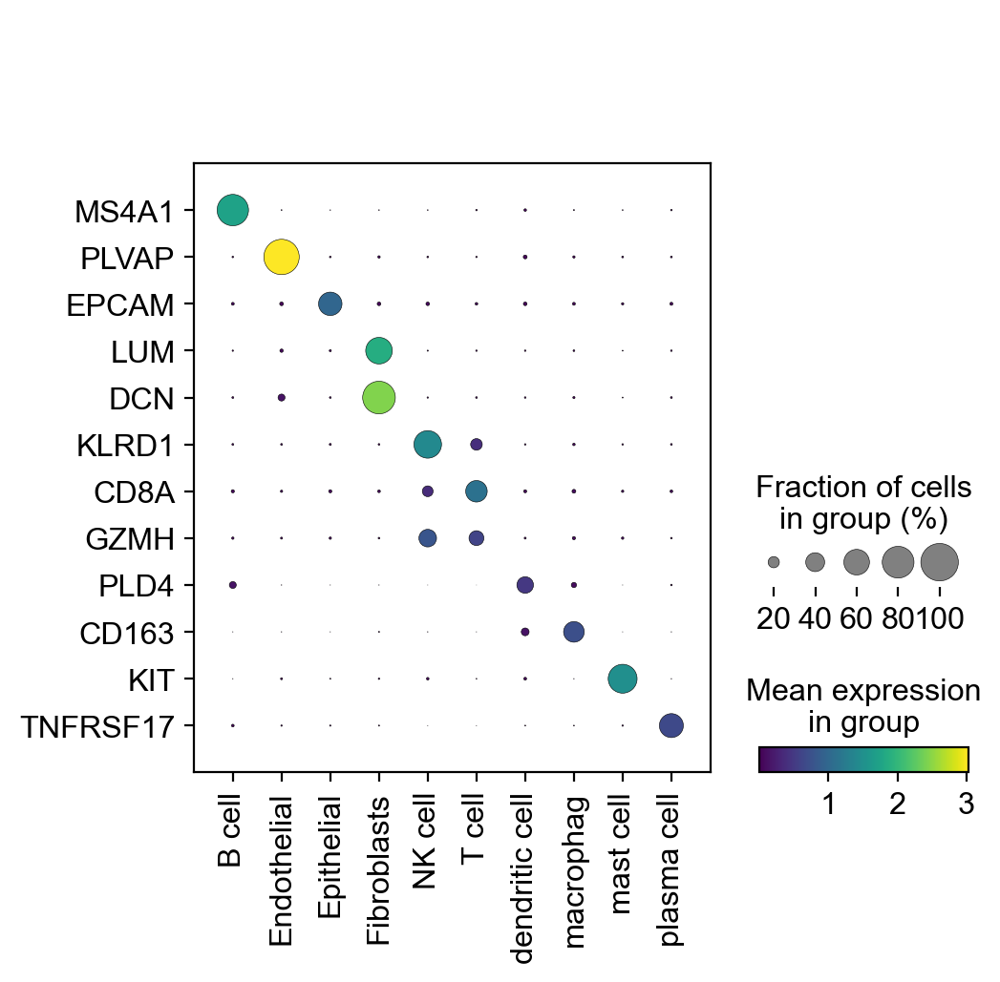

In [15]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.dotplot(adata, cluster, 'celltype', dendrogram=True,cmap='viridis',save='marker1.png')
sc.pl.dotplot(adata,marker_list, 'celltype',cmap='viridis',swap_axes=True,save='marker2.png')

In [16]:
marker_list

['MS4A1',
 'PLVAP',
 'EPCAM',
 'LUM',
 'DCN',
 'KLRD1',
 'CD8A',
 'GZMH',
 'PLD4',
 'CD163',
 'KIT',
 'TNFRSF17']

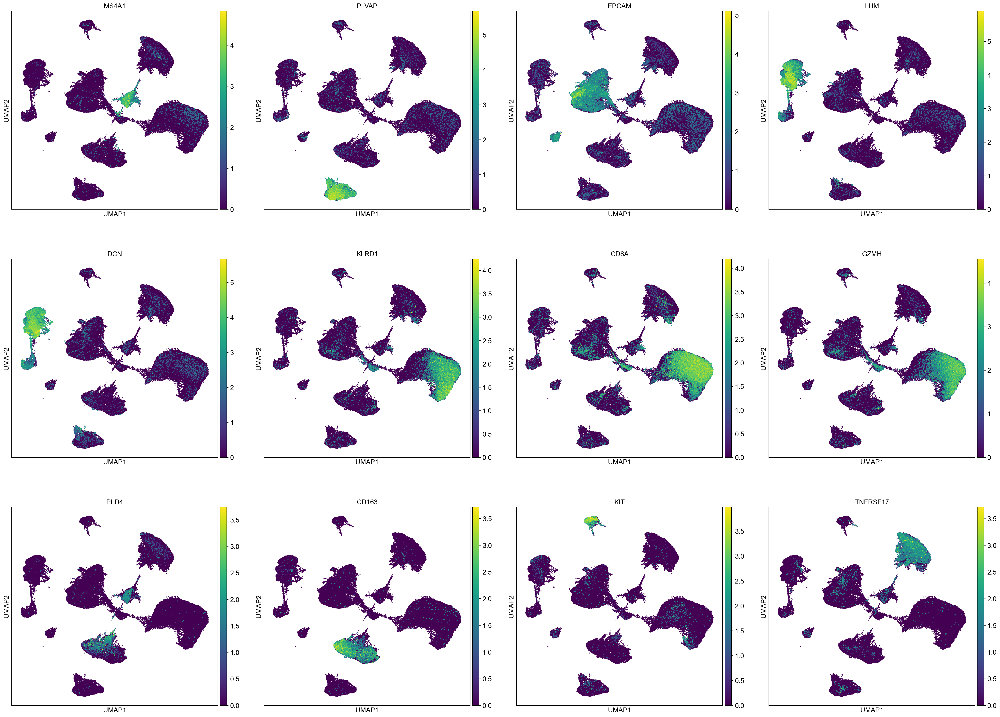

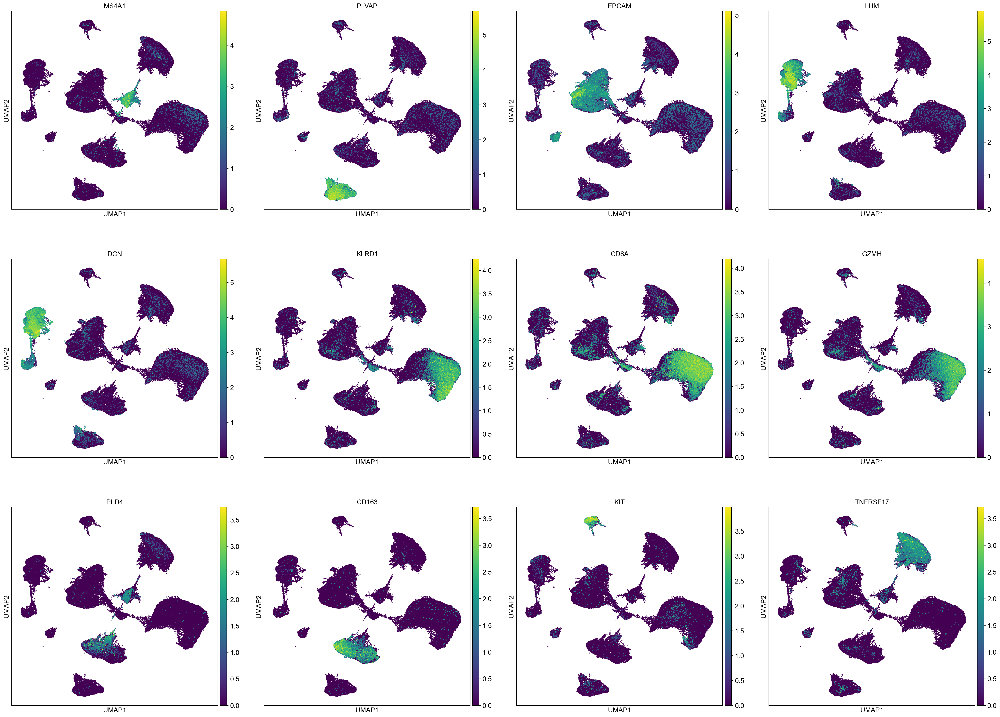

In [17]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.umap(adata,color=marker_list,ncols=4,cmap='viridis',size=15,legend_fontsize=12,save='marke.pdf')
sc.pl.umap(adata,color=marker_list,ncols=4,cmap='viridis',size=15,legend_fontsize=12,save='marke.png',show=False)

In [18]:
import os
os.makedirs('./figures/marker/', exist_ok=True)
path = './figures/marker/'
sc.settings.figdir = path
for i in marker_list:
    sc.pl.umap(adata,color=i,cmap='viridis',size=15,legend_fontsize=12,save=i,show=False)

In [3]:
adata1 = sc.read_h5ad('Epithelial.h5ad')

In [20]:
adata1.obs

,orig.ident,nCount_RNA,nFeature_RNA,Organization,Patients_ID,percent.mt,percent.rb,percent.HB,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.3,RNA_snn_res.0.5,singleR,celltype,immune_annotation,copykat.pred,nCount_SCT,nFeature_SCT,SCT_snn_res.0.8
GSM5573499_CATATTCGTCAGAAGC_38,GSM5573499,2519.0,1227,Tumor,NGCII541,4.009528,21.079794,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,4694.0,1239,9
GSM5573499_CTAACTTAGCACACAG_38,GSM5573499,6546.0,2244,Tumor,NGCII541,0.320807,29.300336,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,5750.0,2241,9
GSM5573499_CACAGTATCCGCAAGC_38,GSM5573499,3091.0,1424,Tumor,NGCII541,0.226464,27.305079,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,4739.0,1433,9
GSM5573499_GTAACGTAGACAAGCC_38,GSM5573499,1670.0,770,Tumor,NGCII541,0.119760,35.089820,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,4689.0,869,9
GSM5573499_GTCTTCGCACCCTATC_38,GSM5573499,9539.0,2743,Tumor,NGCII541,0.628997,25.746934,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,6019.0,2683,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5573474_GTAGTCAAGCGGATCA_16,GSM5573474,1697.0,865,Normal,NGCII525,12.669417,7.896288,0.0,34,16,1,1,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,4462.0,964,16
GSM5573488_GAGCAGAGTAACGACG_6,GSM5573488,4210.0,1597,Normal,NGCII514,5.106888,7.909739,0.0,34,16,8,13,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,4881.0,1597,16
GSM5573488_ACTTTCACATCGGAAG_6,GSM5573488,6542.0,2039,Normal,NGCII514,0.244574,18.923876,0.0,34,16,8,13,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,5748.0,2039,16
GSM5573488_GCATGATGTCCGTTAA_6,GSM5573488,1932.0,991,Normal,NGCII514,5.538302,9.679089,0.0,34,16,8,13,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,4529.0,1062,16


In [34]:
adata1.obs['copykat']=adata1.obs['copykat.pred']

In [35]:
adata1.obs

,orig.ident,nCount_RNA,nFeature_RNA,Organization,Patients_ID,percent.mt,percent.rb,percent.HB,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.3,RNA_snn_res.0.5,singleR,celltype,immune_annotation,copykat.pred,nCount_SCT,nFeature_SCT,SCT_snn_res.0.8,copykat
GSM5573499_CATATTCGTCAGAAGC_38,GSM5573499,2519.0,1227,Tumor,NGCII541,4.009528,21.079794,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,4694.0,1239,9,Malignant cells
GSM5573499_CTAACTTAGCACACAG_38,GSM5573499,6546.0,2244,Tumor,NGCII541,0.320807,29.300336,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,5750.0,2241,9,Malignant cells
GSM5573499_CACAGTATCCGCAAGC_38,GSM5573499,3091.0,1424,Tumor,NGCII541,0.226464,27.305079,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,4739.0,1433,9,Malignant cells
GSM5573499_GTAACGTAGACAAGCC_38,GSM5573499,1670.0,770,Tumor,NGCII541,0.119760,35.089820,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,4689.0,869,9,Malignant cells
GSM5573499_GTCTTCGCACCCTATC_38,GSM5573499,9539.0,2743,Tumor,NGCII541,0.628997,25.746934,0.0,26,9,1,28,Epithelial_cells,Epithelial_cells,epi,Malignant cells,6019.0,2683,9,Malignant cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5573474_GTAGTCAAGCGGATCA_16,GSM5573474,1697.0,865,Normal,NGCII525,12.669417,7.896288,0.0,34,16,1,1,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,4462.0,964,16,Epithelial cells
GSM5573488_GAGCAGAGTAACGACG_6,GSM5573488,4210.0,1597,Normal,NGCII514,5.106888,7.909739,0.0,34,16,8,13,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,4881.0,1597,16,Epithelial cells
GSM5573488_ACTTTCACATCGGAAG_6,GSM5573488,6542.0,2039,Normal,NGCII514,0.244574,18.923876,0.0,34,16,8,13,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,5748.0,2039,16,Epithelial cells
GSM5573488_GCATGATGTCCGTTAA_6,GSM5573488,1932.0,991,Normal,NGCII514,5.538302,9.679089,0.0,34,16,8,13,Epithelial_cells,Epithelial_cells,epi,Epithelial cells,4529.0,1062,16,Epithelial cells


... storing 'orig.ident' as categorical
... storing 'Organization' as categorical
... storing 'Patients_ID' as categorical
... storing 'singleR' as categorical
... storing 'celltype' as categorical
... storing 'immune_annotation' as categorical
... storing 'copykat.pred' as categorical


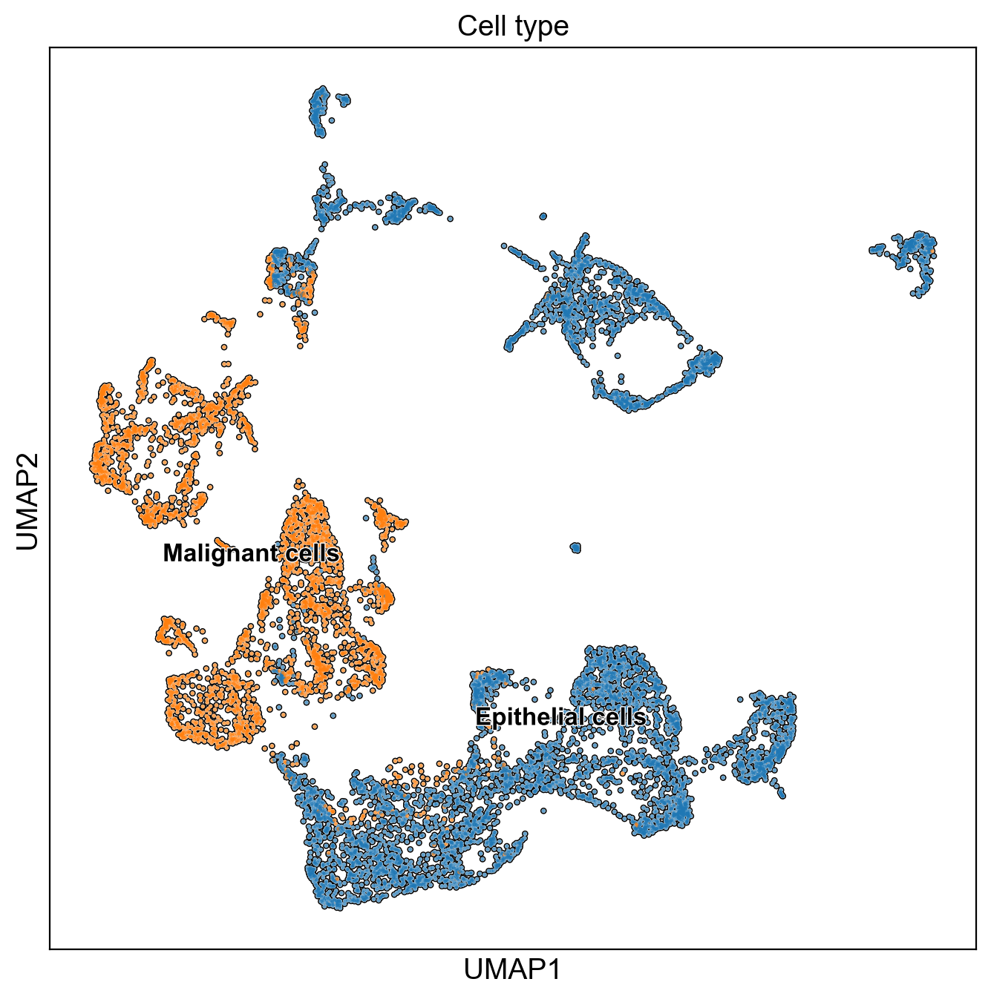

<AxesSubplot:title={'center':'Cell type'}, xlabel='UMAP1', ylabel='UMAP2'>

In [21]:
sc.settings.figdir = './figures/'
sc.pl.umap(adata1, color='copykat.pred', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=1,frameon=True,
               title='Cell type',save='Epithelial_1.png')
sc.pl.umap(adata1, color='copykat.pred', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=1,frameon=True,
               title='Cell type',save='Epithelial_1.pdf',show=False)

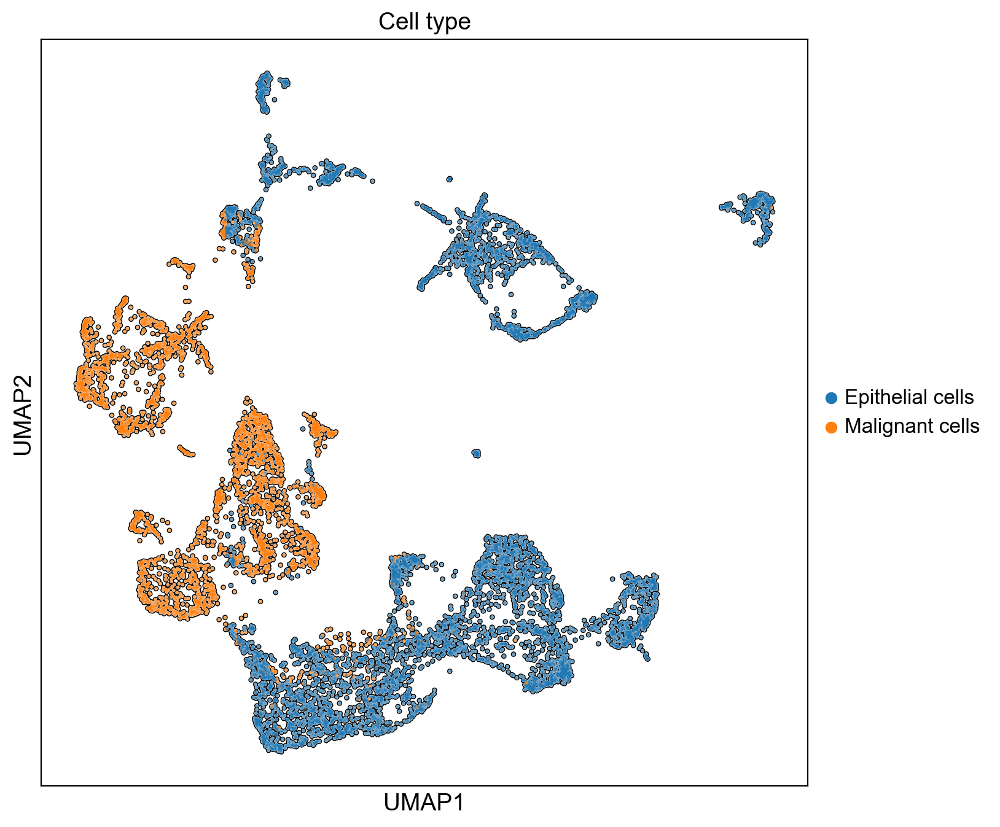

<AxesSubplot:title={'center':'Cell type'}, xlabel='UMAP1', ylabel='UMAP2'>

In [5]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.settings.figdir = './figures/'
sc.pl.umap(adata1, color='copykat.pred', add_outline=True, legend_loc='right margin',
               legend_fontsize=12, legend_fontoutline=1,frameon=True,
               title='Cell type',save='Epithelial_2.png')
sc.pl.umap(adata1, color='copykat.pred', add_outline=True, legend_loc='right margin',
               legend_fontsize=12, legend_fontoutline=1,frameon=True,
               title='Cell type',save='Epithelial_2.pdf',show=False) 

In [39]:
original_order = ['Malignant cells','Epithelial cells']


In [41]:
adata1.obs['copykat'] = adata1.obs.copykat.cat.set_categories(original_order)

In [42]:
def draw_population_ratio(df:pd.DataFrame, x:str, y:str,
                          * ,data_colors:dict=None,
                          normalize=True,
                          path=None,
                          legend=True,
                          figsize=(6, 3)):
    df = df[[x, y]]
    x_items = df[x].cat.categories.tolist()
    y_items = df[y].cat.categories.tolist()
    y_dict = df[y].value_counts().to_dict()
    
    heights = []
    for x_item in x_items:
        tmp_result = []
        x_item_counter = df[df[x]==x_item][y].value_counts().to_dict()
        for y_item in y_items:
            tmp_result.append(x_item_counter.get(y_item, 0))
        heights.append(tmp_result)
    heights = np.asarray(heights)
    if normalize:
        heights = heights/np.sum(heights, axis=0)
    heights = (heights.T/np.sum(heights, axis=1)).T
    plt.figure(figsize=figsize)
    _last = np.matrix([0.]* heights.shape[0])
    for i, y_item in enumerate(y_items):
        p = plt.bar(range(0, heights.shape[0]), heights[:, i],
                    bottom=np.asarray(_last)[0],
                    color=data_colors.get(y_item, 'b'),
                    label=y_item
                   )
        _last = _last + np.matrix(heights[:, i])
    plt.xticks(range(0, len(x_items)),labels=x_items, rotation=70)
    plt.ylim((0, 1))
    if legend:
        plt.legend()
        ax = plt.gca()
        ax.legend(bbox_to_anchor=(0.65, 0, 0.5, 1))
    if path is not None:
        plt.savefig(path, dpi=300)

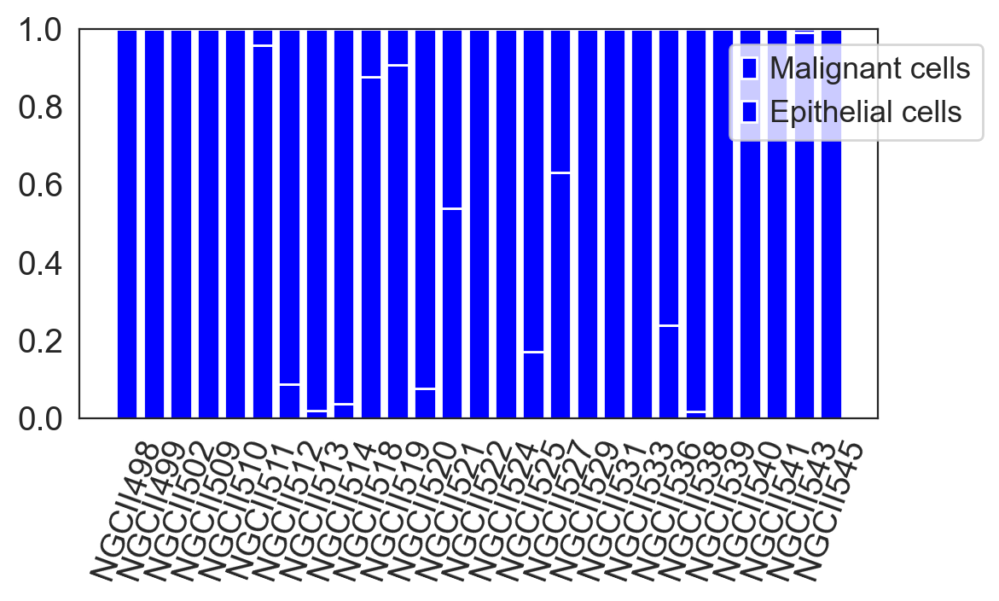

In [53]:
adata1.obs['patient'] = adata1.obs.Patients_ID.astype('category')
sns.set_style('white')
draw_population_ratio(adata1.obs, x='patient', y='copykat',
                      data_colors=dict(zip(adata1.obs.patient.cat.categories,adata1.uns['copykat.pred_colors']))
                     )

In [54]:
adata2 = sc.read_h5ad('B_cell.h5ad')

D:\anaconda\lib\site-packages\anndata\compat\__init__.py:180: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(


In [55]:
adata2.obs

,orig.ident,nCount_RNA,nFeature_RNA,Organization,Patients_ID,percent.mt,percent.rb,percent.HB,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.3,RNA_snn_res.0.5,singleR,celltype,immune_annotation,nCount_SCT,nFeature_SCT,SCT_snn_res.0.5,B_annotation
GSM5573466_AAATGCCTCGTCTGCT_8,GSM5573466,4507.0,1635,Normal,NGCII518,7.344131,23.696472,0.000000,9,0,19,27,B_cell,B_cell,immune,4673.0,1635,0,Memory B cell
GSM5573466_AACCGCGTCGTTACAG_8,GSM5573466,6981.0,1289,Normal,NGCII518,3.581149,11.631571,0.000000,3,5,15,22,B_cell,B_cell,immune,5949.0,1289,5,Plasma cell
GSM5573466_AACTCCCGTTAGAACA_8,GSM5573466,2467.0,639,Normal,NGCII518,3.323875,5.350628,0.000000,3,7,15,22,B_cell,B_cell,immune,3704.0,640,7,Plasma cell
GSM5573466_AACTCTTGTTATTCTC_8,GSM5573466,6591.0,1388,Normal,NGCII518,5.856471,9.952966,0.000000,3,13,15,22,B_cell,B_cell,immune,5806.0,1385,13,Plasma cell
GSM5573466_AACTTTCAGCTCCTTC_8,GSM5573466,6179.0,1829,Normal,NGCII518,6.635378,16.701732,0.000000,9,0,19,27,B_cell,B_cell,immune,5684.0,1829,0,Memory B cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM5573505_TTTGATCAGGGTACGT.1_40,GSM5573505,8377.0,1205,Tumor,NGCII545,4.918228,8.583025,0.000000,15,10,15,22,B_cell,B_cell,immune,6244.0,1204,10,Plasma cell
GSM5573505_TTTGATCCATGGGAAC.1_40,GSM5573505,6499.0,1264,Tumor,NGCII545,4.154485,15.202339,0.015387,15,7,15,22,B_cell,B_cell,immune,5753.0,1264,7,Plasma cell
GSM5573505_TTTGATCGTGGACCTC.1_40,GSM5573505,5117.0,826,Tumor,NGCII545,9.028728,9.087356,0.000000,15,2,15,22,B_cell,B_cell,immune,5077.0,826,2,Plasma cell
GSM5573505_TTTGGTTTCTTCCCAG.1_40,GSM5573505,10538.0,1327,Tumor,NGCII545,3.871702,4.545455,0.000000,15,10,15,22,B_cell,B_cell,immune,6872.0,1287,10,Plasma cell


... storing 'orig.ident' as categorical
... storing 'Organization' as categorical
... storing 'Patients_ID' as categorical
... storing 'singleR' as categorical
... storing 'celltype' as categorical
... storing 'immune_annotation' as categorical
... storing 'B_annotation' as categorical


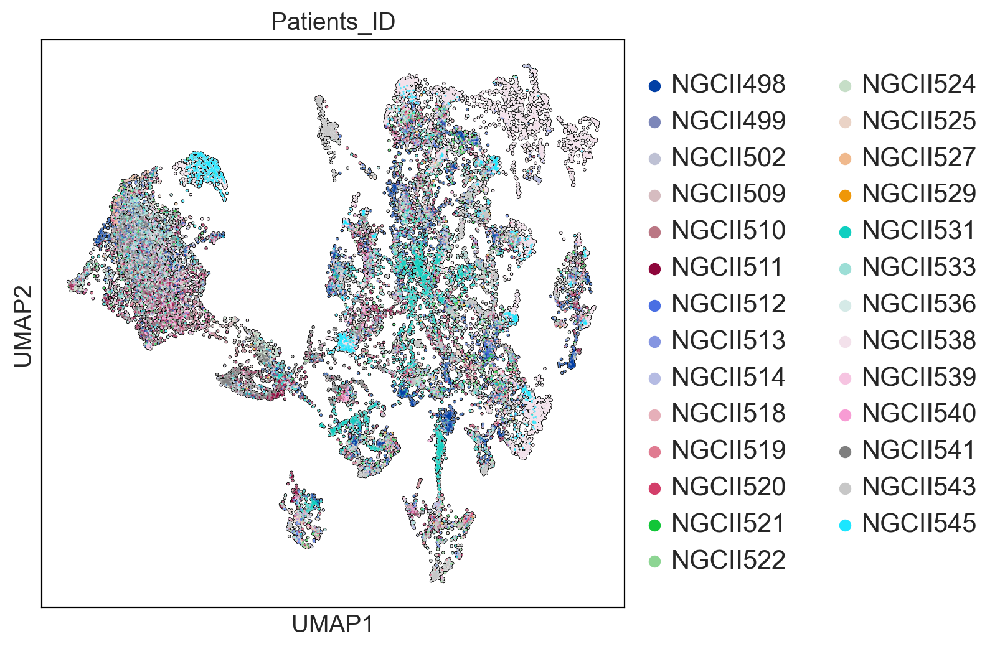

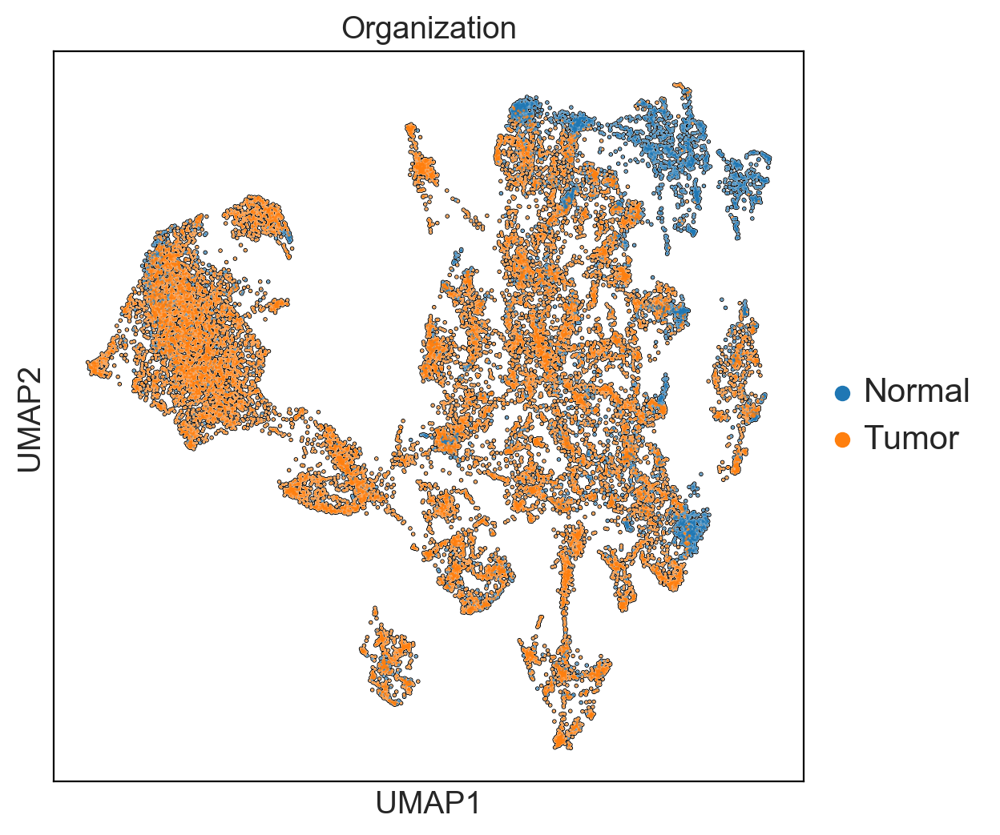

In [56]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(6,6))
type =['Patients_ID','Organization']
for i in type:
    sc.pl.umap(adata2, color=i,add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline=1,frameon=True,ncols=1,save = i
               )

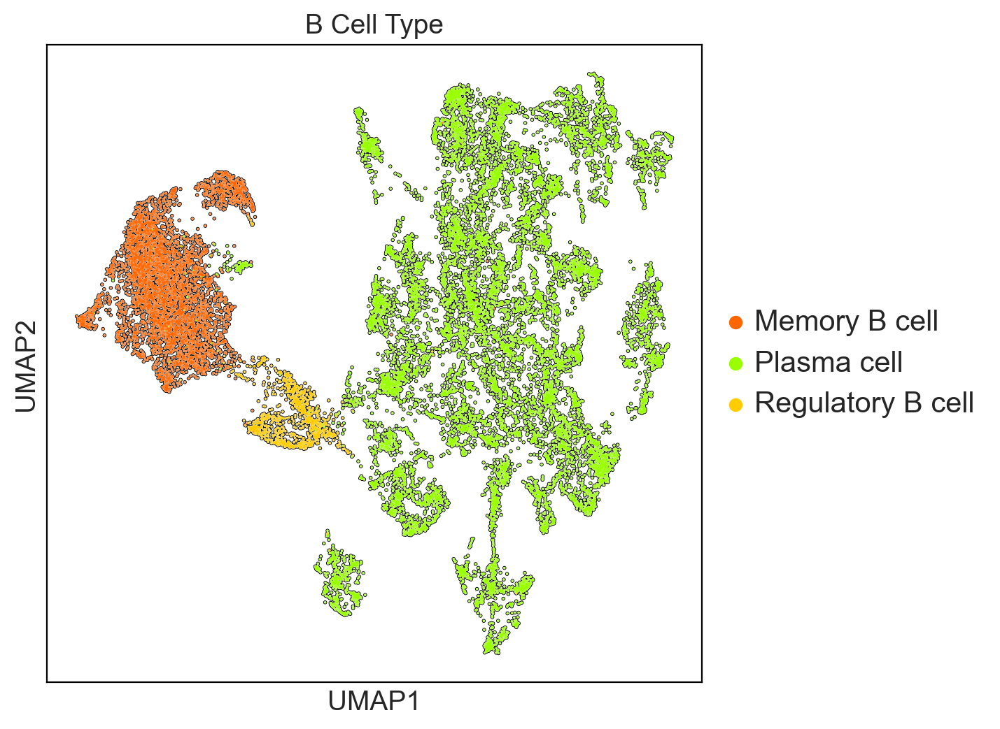

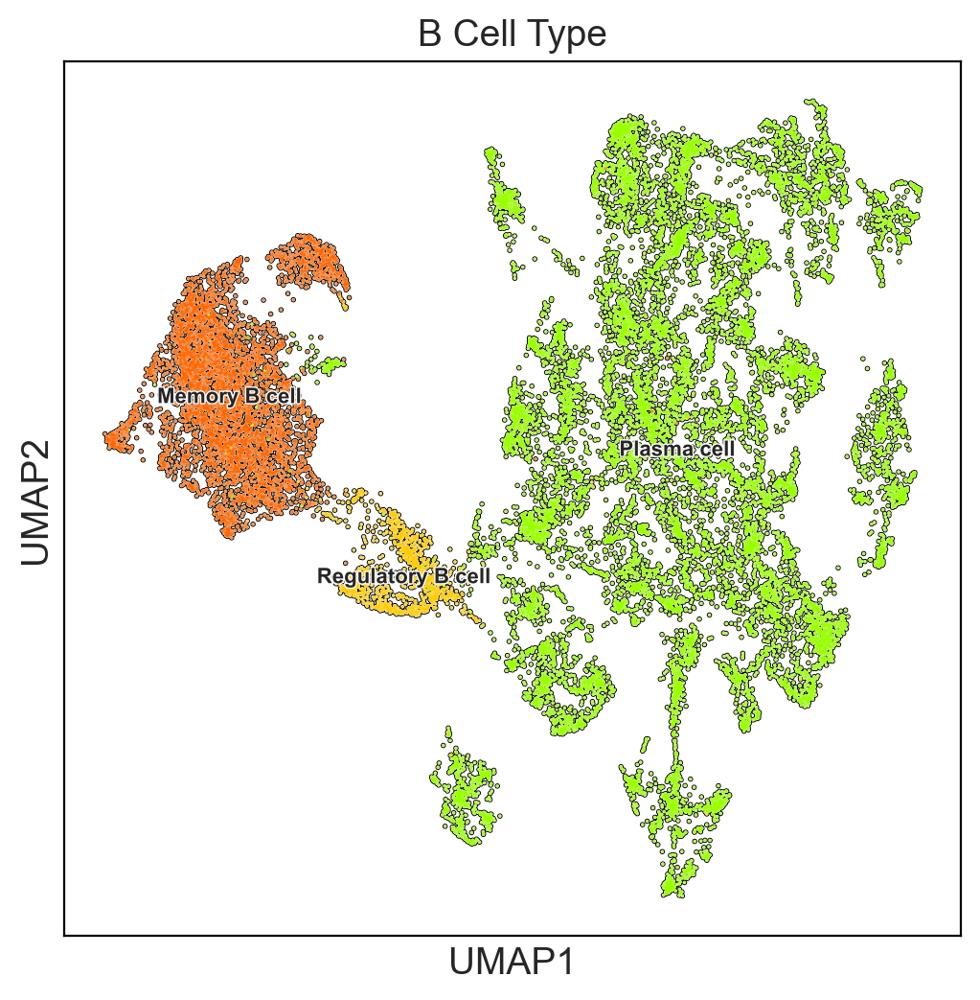

<AxesSubplot:title={'center':'B Cell Type'}, xlabel='UMAP1', ylabel='UMAP2'>

In [62]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(6,6))
B_color = ['#FF6600', '#99FF00', '#FFCC00']
sc.pl.umap(adata2, color=['B_annotation'],add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline=1,frameon=True,title='B Cell Type',palette=B_color,save='B_cell1.pdf'
               )
sc.pl.umap(adata2, color=['B_annotation'],add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline=1,frameon=True,title='B Cell Type',palette=B_color,save='B_cell1.png',show=False
               )
sc.pl.umap(adata2, color=['B_annotation'],add_outline=True, legend_loc='on data',
               legend_fontsize=8, legend_fontoutline=1,frameon=True,title='B Cell Type',palette=B_color,save='B_cell2.pdf'
               )
sc.pl.umap(adata2, color=['B_annotation'],add_outline=True, legend_loc='on data',
               legend_fontsize=8, legend_fontoutline=1,frameon=True,title='B Cell Type',palette=B_color,save='B_cell2.png',show=False
               )